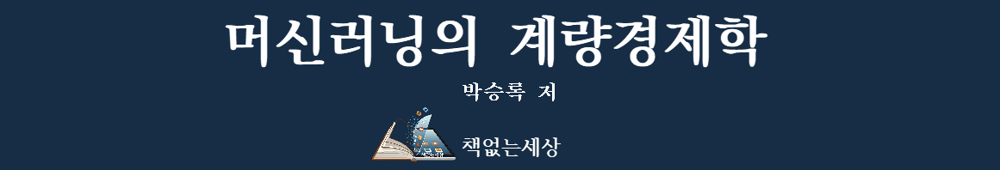

# Part 8: 머신러닝의 계량경제

## Chapter 3: 머신러닝의 자동화: Pycaret 활용

### 6. Pycaret를 이용한 단변량 시계열 분석

In [1]:
# 작업공간(working directory)지정  
import os  
os.chdir("X:/Econometrics_with_ML")
# 현재 작업공간(working directory)확인  
os.getcwd() 

'X:\\Econometrics_with_ML'

In [2]:
# 라이브러리 불러오기
exec(open('Functions/Machine Learning_Econometrics_Lib.py').read())

In [3]:
# 한국의 거시경제 통계자료 불러오기
data = pd.read_csv('Data/Korea_GDP.csv',index_col='Time', parse_dates=True)

new_index = pd.date_range(start='1961-03-31', periods=len(data), freq='Q')
data.index = pd.to_datetime(new_index)

df = data.loc[data.index >= '2000-01-31', 'gdp']
df

2000-03-31    210585.8
2000-06-30    225287.6
2000-09-30    230172.3
2000-12-31    237505.2
2001-03-31    221365.2
                ...   
2022-12-31    513770.2
2023-03-31    472155.5
2023-06-30    497345.6
2023-09-30    500997.0
2023-12-31    525122.8
Freq: Q-DEC, Name: gdp, Length: 96, dtype: float64

<Axes: >

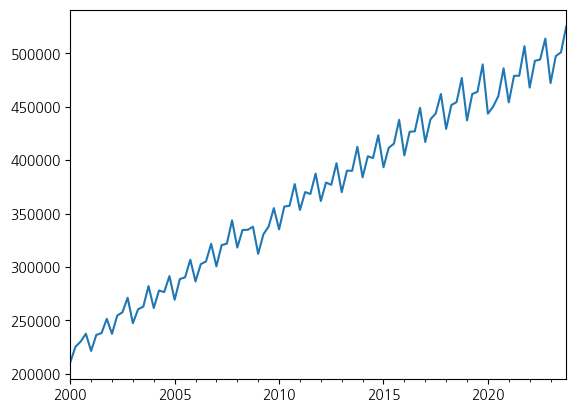

In [4]:
# plot the dataset
df.plot()

#### 가. 모형의 셋업(Setup)

In [5]:
from pycaret.time_series import *
s = setup(df, fh = 4, session_id = 12345)

,Description,Value
0,session_id,12345
1,Target,gdp
2,Approach,Univariate
3,Exogenous Variables,Not Present
4,Original data shape,"(96, 1)"
5,Transformed data shape,"(96, 1)"
6,Transformed train set shape,"(92, 1)"
7,Transformed test set shape,"(4, 1)"
8,Rows with missing values,0.0%
9,Fold Generator,ExpandingWindowSplitter


#### 나. 시계열 자료의 요약 통계량 

In [6]:
# 데이터세트에 요약통계 및 안정성 검정
check_stats()

,Test,Test Name,Data,Property,Setting,Value
0,Summary,Statistics,Transformed,Length,,96.0
1,Summary,Statistics,Transformed,# Missing Values,,0.0
2,Summary,Statistics,Transformed,Mean,,369366.046875
3,Summary,Statistics,Transformed,Median,,373489.7
4,Summary,Statistics,Transformed,Standard Deviation,,85108.080683
5,Summary,Statistics,Transformed,Variance,,7243385397.538307
6,Summary,Statistics,Transformed,Kurtosis,,-1.146605
7,Summary,Statistics,Transformed,Skewness,,-0.081538
8,Summary,Statistics,Transformed,# Distinct Values,,96.0
9,White Noise,Ljung-Box,Transformed,Test Statictic,"{'alpha': 0.05, 'K': 24}",1058.092322


#### 다. 설명적 데이터 분석(Exploratory Data Analysis: EDA)

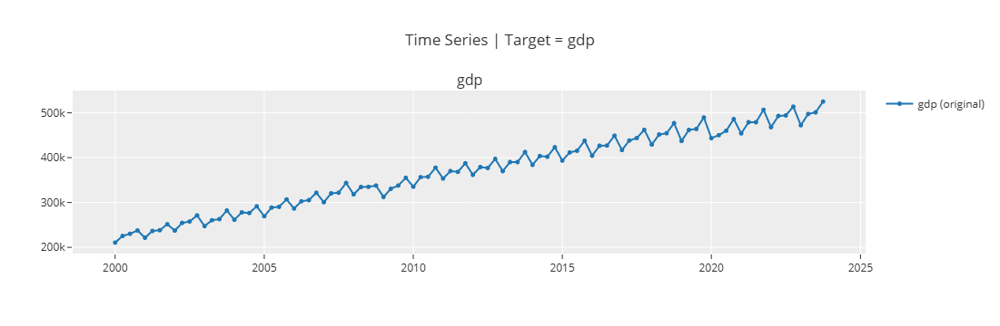

In [7]:
# 원시계열 그래프
plot_model(plot = 'ts')

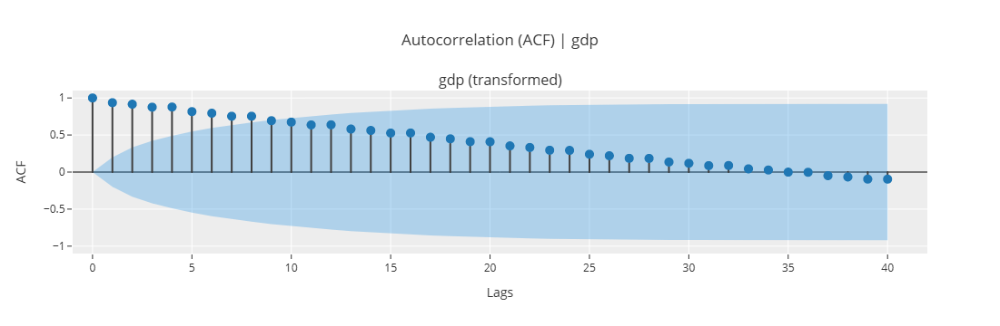

In [8]:
# 자기상관함수 그래프(plot acf)
plot_model(plot = 'acf')

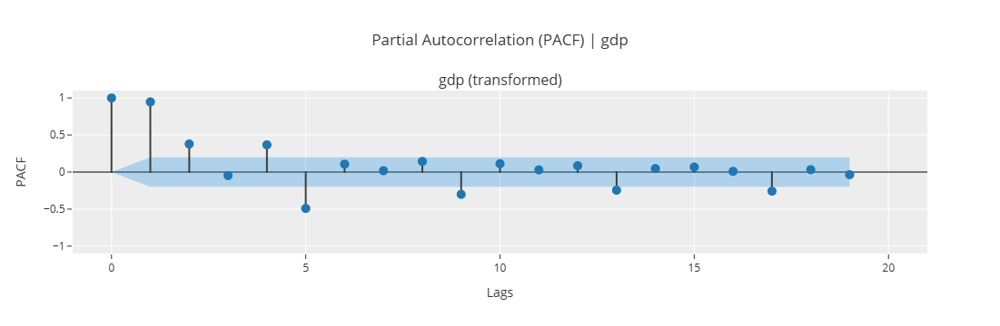

In [9]:
# 편자기상관함수 그래프(plot pacf)
plot_model(plot = 'pacf')

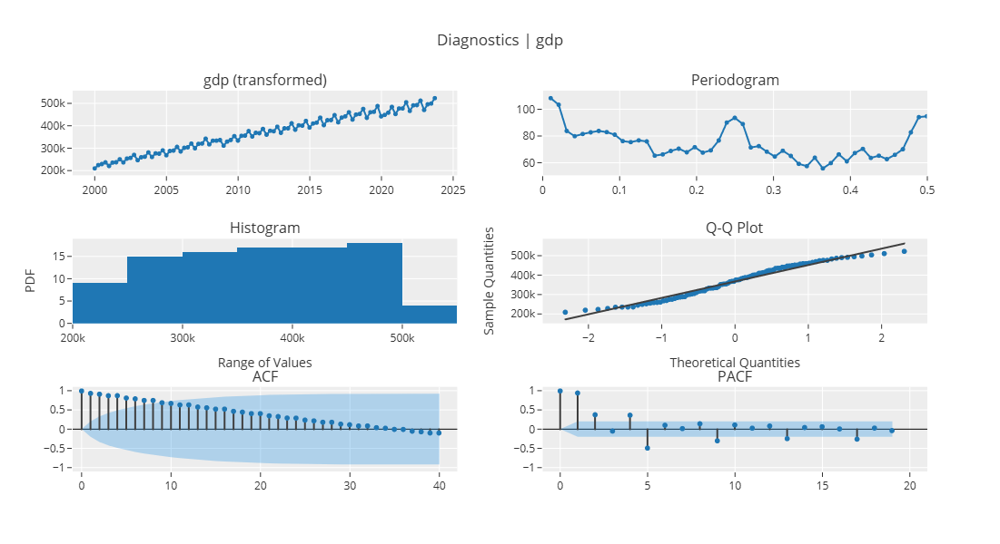

In [10]:
# 종합진단 그래프(plot diagnostics)
plot_model(plot = 'diagnostics', fig_kwargs={"height": 600, "width": 900})

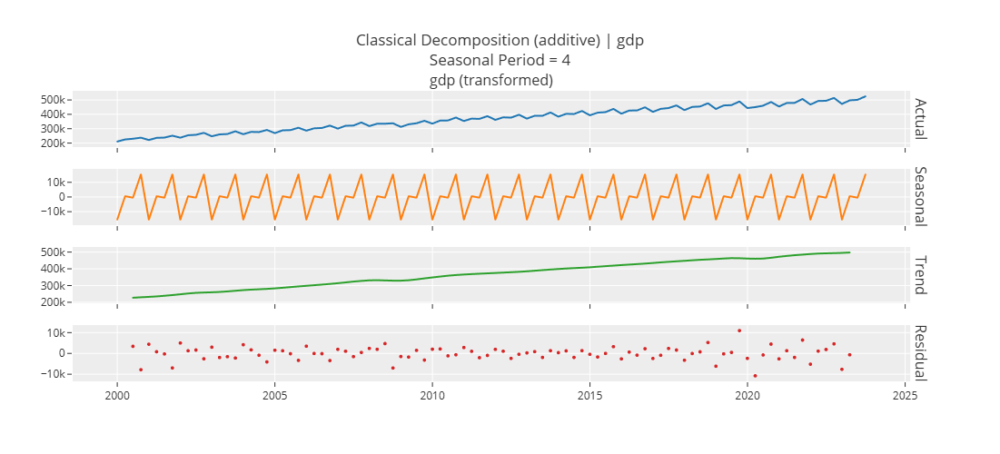

In [11]:
# 시계열 자료의 고전적 분해(classical decomposition)
plot_model(plot="decomp", fig_kwargs={"height": 500})

#### 라. 모형의 추정과 성능 평가

In [12]:
# 이용가능 모형 리스트
models()

,Name,Reference,Turbo
ID,,,
naive,Naive Forecaster,sktime.forecasting.naive.NaiveForecaster,True
grand_means,Grand Means Forecaster,sktime.forecasting.naive.NaiveForecaster,True
snaive,Seasonal Naive Forecaster,sktime.forecasting.naive.NaiveForecaster,True
polytrend,Polynomial Trend Forecaster,sktime.forecasting.trend._polynomial_trend_for...,True
arima,ARIMA,sktime.forecasting.arima.ARIMA,True
auto_arima,Auto ARIMA,sktime.forecasting.arima.AutoARIMA,True
exp_smooth,Exponential Smoothing,sktime.forecasting.exp_smoothing.ExponentialSm...,True
ets,ETS,sktime.forecasting.ets.AutoETS,True
theta,Theta Forecaster,sktime.forecasting.theta.ThetaForecaster,True


In [13]:
# 다양한 앨고리즘을 이용한 모형 추정
best = compare_models()

,Model,MASE,RMSSE,MAE,RMSE,MAPE,SMAPE,R2,TT (Sec)
theta,Theta Forecaster,0.6520,0.6632,8349.5410,9003.6736,0.0179,0.0177,0.5420,0.0400
huber_cds_dt,Huber w/ Cond. Deseasonalize & Detrending,0.6848,0.7152,8793.0990,9736.8328,0.0190,0.0187,0.4652,0.0767
ets,ETS,0.6989,0.7158,8968.9292,9742.3936,0.0192,0.0189,0.4431,0.0500
et_cds_dt,Extra Trees w/ Cond. Deseasonalize & Detrending,0.6990,0.7331,8985.6643,9992.2615,0.0194,0.0191,0.4647,0.1433
exp_smooth,Exponential Smoothing,0.7109,0.7254,9127.6944,9878.5637,0.0195,0.0192,0.4224,0.0533
auto_arima,Auto ARIMA,0.7130,0.7517,9127.3819,10205.4200,0.0193,0.0192,0.5135,0.3733
rf_cds_dt,Random Forest w/ Cond. Deseasonalize & Detrending,0.7287,0.7547,9366.0663,10293.9523,0.0202,0.0198,0.4370,0.1633
llar_cds_dt,Lasso Least Angular Regressor w/ Cond. Deseasonalize & Detrending,0.7600,0.7857,9758.6970,10701.0252,0.0211,0.0207,0.4036,0.0800
lr_cds_dt,Linear w/ Cond. Deseasonalize & Detrending,0.7600,0.7857,9758.6969,10701.0252,0.0211,0.0207,0.4036,0.3067
lasso_cds_dt,Lasso w/ Cond. Deseasonalize & Detrending,0.7600,0.7857,9758.6970,10701.0252,0.0211,0.0207,0.4036,0.0733


#### 마. 하이퍼파라미터 튜닝

In [15]:
# 하이퍼파라미터 튜닝
best_tuned_model = tune_model(best)

,cutoff,MASE,RMSSE,MAE,RMSE,MAPE,SMAPE,R2
0,2019Q4,1.2648,1.2846,16320.4550,17525.0073,0.0357,0.0349,-0.1757
1,2020Q4,0.5940,0.6083,7472.8761,8147.5749,0.0153,0.0155,0.8085
2,2021Q4,0.0971,0.0967,1255.2921,1338.4387,0.0026,0.0026,0.9932
Mean,NaT,0.6520,0.6632,8349.5410,9003.6736,0.0179,0.0177,0.5420
SD,NaT,0.4785,0.4865,6181.4879,6635.8084,0.0136,0.0133,0.5131


Fitting 3 folds for each of 2 candidates, totalling 6 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   6 out of   6 | elapsed:    0.0s finished


#### 바. 예측

In [16]:
# check docstring to see available plots
help(plot_model)

Help on function plot_model in module pycaret.time_series.forecasting.functional:

plot_model(estimator: Optional[Any] = None, plot: Optional[str] = None, return_fig: bool = False, return_data: bool = False, verbose: bool = False, display_format: Optional[str] = None, data_kwargs: Optional[Dict] = None, fig_kwargs: Optional[Dict] = None, save: Union[str, bool] = False) -> Optional[Tuple[str, list]]
    This function analyzes the performance of a trained model on holdout set.
    When used without any estimator, this function generates plots on the
    original data set. When used with an estimator, it will generate plots on
    the model residuals.
    
    
    Example
    --------
    >>> from pycaret.datasets import get_data
    >>> airline = get_data('airline')
    >>> from pycaret.time_series import *
    >>> exp_name = setup(data = airline,  fh = 12)
    >>> plot_model(plot="diff", data_kwargs={"order_list": [1, 2], "acf": True, "pacf": True})
    >>> plot_model(plot="diff", data

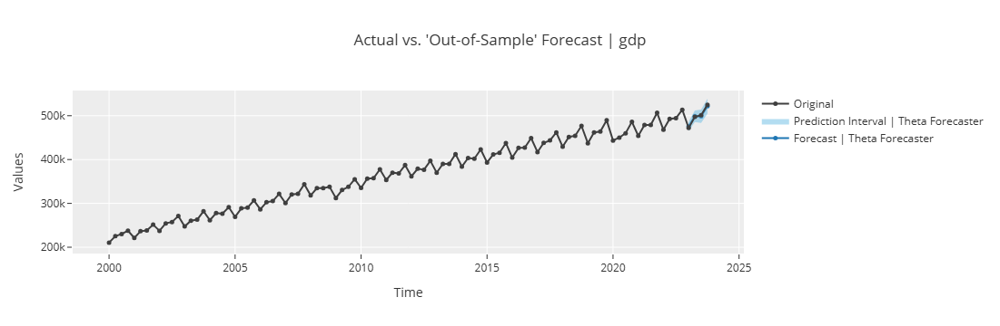

In [17]:
# 검정 데이터세트에 대한 예측(사후예측)
plot_model(best, plot = 'forecast')

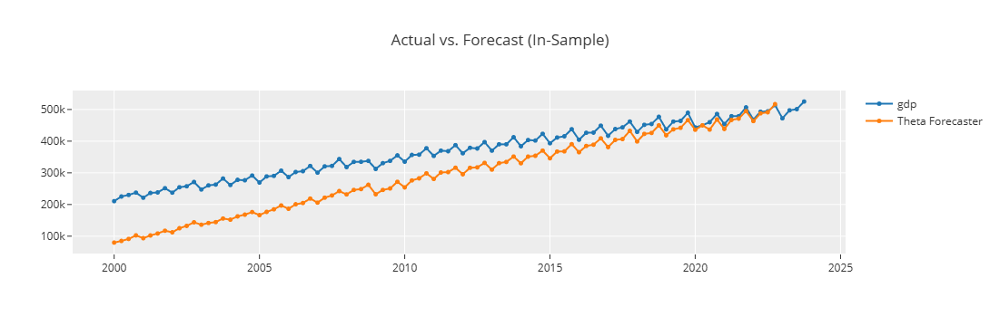

In [18]:
# 샘플 내 예측(in-sample plot)
plot_model(best, plot = 'insample')

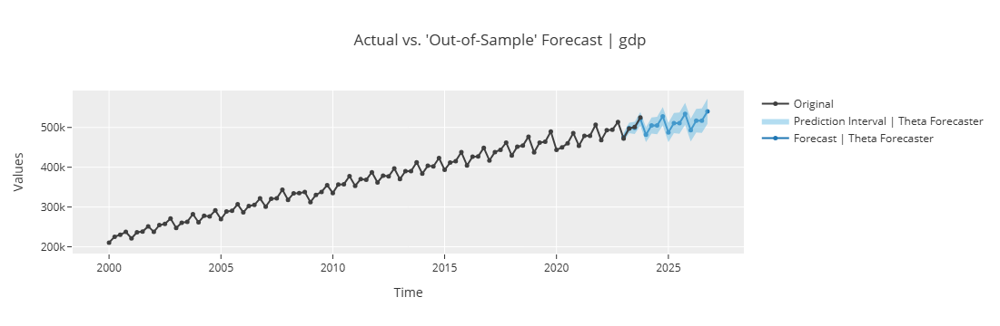

In [19]:
# 미래 예측(사전예측)
plot_model(best, plot = 'forecast', data_kwargs = {'fh' : 16})

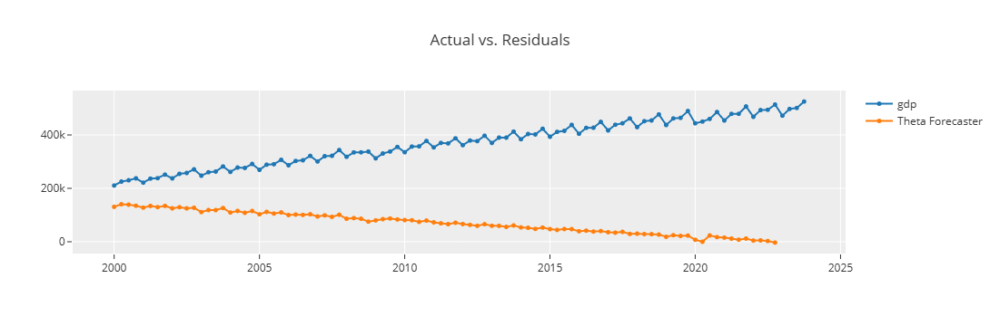

In [20]:
# 잔차 그래프
plot_model(best, plot = 'residuals')

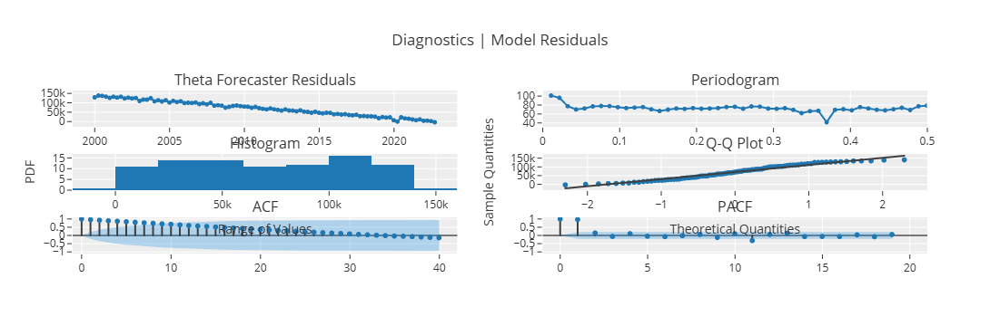

In [21]:
# 최종모형의 진단(diagnostics plot)
plot_model(best, plot = 'diagnostics')

In [22]:
# 최종모형(finalize model)을 이용한 예측치
final_best = finalize_model(best) 
predict_model(final_best, fh = 16)

,y_pred
2024Q1,486073.3912
2024Q2,509737.4202
2024Q3,509730.1095
2024Q4,532951.3734
2025Q1,491836.1638
2025Q2,515762.8889
2025Q3,515737.7381
2025Q4,539214.2321
2026Q1,497598.9364
2026Q2,521788.3575


#### 6) 모형저장 및 로딩(loading)

In [23]:
# save pipeline
save_model(best, './Output/Model_timeseries')

Transformation Pipeline and Model Successfully Saved


(ForecastingPipeline(steps=[('forecaster',
                             TransformedTargetForecaster(steps=[('model',
                                                                 ThetaForecaster(sp=4))]))]),
 './Output/Model_timeseries.pkl')

In [24]:
# load pipeline
loaded_best_pipeline = load_model('./Output/Model_timeseries')
loaded_best_pipeline

Transformation Pipeline and Model Successfully Loaded


ForecastingPipeline(steps=[('forecaster',
                            TransformedTargetForecaster(steps=[('model',
                                                                ThetaForecaster(sp=4))]))])

In [ ]:
# load model
loaded_from_disk = load_model('my_first_model')
loaded_from_disk

Transformation Pipeline and Model Successfully Loaded


AutoETS(seasonal='mul', sp=12, trend='add')

### [보완] 외생변수를 가진 단변량 시계열 모형

In [26]:
# 작업공간(working directory)지정  
import os  
os.chdir("E:/JupyterWDirectory/MyStock")
# 현재 작업공간(working directory)확인  
os.getcwd() 

'E:\\JupyterWDirectory\\MyStock'

In [27]:
import numpy as np
import pandas as pd

from pycaret.time_series import TSForecastingExperiment

In [28]:
# 한국의 거시경제 통계자료 불러오기
data = pd.read_csv('./Data/Korea_GDP.csv',index_col='Time', parse_dates=True)

new_index = pd.date_range(start='1961-03-31', periods=len(data), freq='Q')
data.index = pd.to_datetime(new_index)
data.index

data.drop(columns=['exch', 'cpi', 'rat'], inplace=True)
print(data)

                 con       inv      gov        ex        im       gdp  \
1961-03-31    8957.5    -659.9   3036.1      43.6     292.3    7000.7   
1961-06-30    6593.8    1736.8   3079.9      56.3     392.2    8141.3   
1961-09-30    6308.6     833.2   2980.0      70.8     283.1    6970.2   
1961-12-31    8740.5     950.7   2922.3      66.8     332.0    8974.2   
1962-03-31    9670.8    -727.9   3058.9      53.9     338.6    7444.8   
...              ...       ...      ...       ...       ...       ...   
2022-12-31  235677.7  159480.4  89949.2  222599.2  194751.5  513770.2   
2023-03-31  233780.3  132942.8  94700.5  212895.0  198370.1  472155.5   
2023-06-30  229263.8  146189.8  89060.8  217836.1  185450.3  497345.6   
2023-09-30  233387.8  148498.3  82449.8  229952.8  192882.0  500997.0   
2023-12-31  237874.7  155198.8  89118.4  244503.0  201819.6  525122.8   

                   m2  
1961-03-31       24.0  
1961-06-30       27.1  
1961-09-30       35.3  
1961-12-31       39.7  
196

In [29]:
# PyCaret을 사용한 자동화된 시계열 모델링
exp_auto = TSForecastingExperiment()
exp_auto.setup(data=data, target='con', seasonal_period=4)

,Description,Value
0,session_id,1763
1,Target,con
2,Approach,Univariate
3,Exogenous Variables,Present
4,Original data shape,"(252, 7)"
5,Transformed data shape,"(252, 7)"
6,Transformed train set shape,"(251, 7)"
7,Transformed test set shape,"(1, 7)"
8,Rows with missing values,0.0%
9,Fold Generator,ExpandingWindowSplitter


In [30]:
# 최적 모델 비교 및 선택
best_model = exp_auto.compare_models()

,Model,MASE,RMSSE,MAE,RMSE,MAPE,SMAPE,TT (Sec)
huber_cds_dt,Huber w/ Cond. Deseasonalize & Detrending,0.1752,0.1378,813.1899,813.1899,0.0035,0.0035,0.0767
ada_cds_dt,AdaBoost w/ Cond. Deseasonalize & Detrending,0.1779,0.1398,824.1831,824.1831,0.0036,0.0036,0.1033
knn_cds_dt,K Neighbors w/ Cond. Deseasonalize & Detrending,0.2136,0.1679,990.0030,990.0030,0.0043,0.0043,0.0700
en_cds_dt,Elastic Net w/ Cond. Deseasonalize & Detrending,0.2648,0.2083,1229.2304,1229.2304,0.0053,0.0053,0.0600
lasso_cds_dt,Lasso w/ Cond. Deseasonalize & Detrending,0.2648,0.2083,1229.2299,1229.2299,0.0053,0.0053,0.0633
arima,ARIMA,0.2996,0.2355,1388.2034,1388.2034,0.0060,0.0060,0.1733
auto_arima,Auto ARIMA,0.3244,0.2550,1501.8805,1501.8805,0.0065,0.0065,12.0100
br_cds_dt,Bayesian Ridge w/ Cond. Deseasonalize & Detrending,0.3555,0.2796,1649.6408,1649.6408,0.0071,0.0071,0.0567
lightgbm_cds_dt,Light Gradient Boosting w/ Cond. Deseasonalize & Detrending,0.3730,0.2933,1730.9072,1730.9072,0.0075,0.0075,0.1733
llar_cds_dt,Lasso Least Angular Regressor w/ Cond. Deseasonalize & Detrending,0.3863,0.3038,1792.4103,1792.4103,0.0077,0.0077,0.0600


In [31]:
# 자동화된 모델의 미래 예측
future_auto_predictions = exp_auto.predict_model(best_model, fh=4)

In [32]:
# 예측 결과 출력
print(future_auto_predictions)

             y_pred
2023Q4  237687.2242
2024Q1  236724.4870
2024Q2  234077.2789
2024Q3  235760.5682
